In [20]:
import h5py
import xarray as xr
import rioxarray as rxr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import earthaccess
import os

In [17]:
collections = earthaccess.search_datasets(keyword = 'NISAR')

for c in collections:
    umm = c.get('umm')
    print(
        umm["ShortName"],
        "-",
        umm["EntryTitle"]
    )

NISAR_L3_SME2_BETA_V1 - NISAR Beta Soil Moisture (Version 1)
NISAR_L2_GCOV_BETA_V1 - NISAR Beta Geocoded Polarimetric Covariance Product (Version 1)
NISAR_L2_GOFF_BETA_V1 - NISAR Beta Geocoded Pixel Offsets (Version 1)
NISAR_L2_GSLC_BETA_V1 - NISAR Beta Geocoded Single Look Complex Product (Version 1)
NISAR_L2_GUNW_BETA_V1 - NISAR Beta Geocoded Unwrapped Interferogram Product (Version 1)
NISAR_OE - NISAR Orbit Ephemeris
NISAR_RP - NISAR Radar Pointing
NISAR_TEC - NISAR Total Electron Content
NISAR_L1_RIFG_BETA_V1 - NISAR Beta Range Doppler Wrapped Interferogram Product (Version 1)
NISAR_L1_ROFF_BETA_V1 - NISAR Beta Range Doppler Pixel Offsets (Version 1)
NISAR_L1_RSLC_BETA_V1 - NISAR Beta Range Doppler Single Look Complex Product (Version 1) 
NISAR_L1_RUNW_BETA_V1 - NISAR Beta Range Doppler Unwrapped Interferogram Product (Version 1)
NISAR_ANC_AUX - NISAR Ancillary and Auxiliary Data
NISAR_COP - NISAR Coordinated Observation Plan
NISAR_LRCLK_UTC - NISAR L-SAR Radar Clock to UTC Convers

In [18]:
results = earthaccess.search_data(
    short_name = 'NISAR_L3_SME2_BETA_V1'
    
)

In [19]:
len(results)

1

In [22]:
earthaccess.login(persist=True)

In [23]:
earthaccess.download(results[0], os.getcwd())

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

['c:\\Users\\ADM_IN\\Desktop\\Personal\\sanjay\\projects\\NISAR\\NISAR_L3_PR_SME2_008_007_D_073_4005_DHDH_A_20251216T164223_20251216T164300_X05007_N_F_J_001.h5']

***

***

In [2]:
sme_path = 'NISAR_L3_PR_SME2_008_007_D_073_4005_DHDH_A_20251216T164223_20251216T164300_X05007_N_F_J_001.h5'

In [3]:
sme = {}

with h5py.File(sme_path, 'r') as f:
    sm_array = f['science']['LSAR']['SME2']['grids']['soilMoisture'][:]
    x = f['science']['LSAR']['SME2']['grids']['xCoordinates'][:]
    y = f['science']['LSAR']['SME2']['grids']['yCoordinates'][:]

    sme['sme'] = sm_array
    sme['x'] = x
    sme['y'] = y
    sme['projection'] = f['science']['LSAR']['SME2']['grids']['projection'][()]

In [40]:
sme.get('x').shape, sme.get('y').shape

((1845,), (1800,))

In [4]:
sme_da = xr.DataArray(data = sme.get('sme'),
                      dims = ['y', 'x'],
                      coords = {
                          'y' : sme.get('y'),
                          'x' : sme.get('x')
                      })

In [5]:
sme_da = xr.where(sme_da < 0, np.nan, sme_da)

In [51]:
np.nanmin(sme_da)

0.020024674

In [52]:
np.nanmax(sme_da)

0.4524854

In [6]:
import plotly.express as px

In [60]:
valid = sme_da.values.ravel()
valid = valid[~np.isnan(valid)]


fig = px.histogram(
    valid,
    nbins=100,
    labels={"value": "Soil Moisture"},
    title="Histogram of Soil Moisture"
)

fig.update_layout(
    xaxis_title="Soil Moisture",
    yaxis_title="Pixel count",
    bargap=0.01
)

fig.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
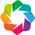

:Overlay
   .WMTS.I  :WMTS   [Longitude,Latitude]
   .Image.I :Image   [x,y]   (SME)

In [10]:
import geoviews as gv
import holoviews as hv
import cartopy.crs as ccrs

hv.extension("bokeh")

raster = gv.Image(
    sme_da,
    crs=ccrs.epsg(sme.get('projection')),
    kdims=["x", "y"],
    vdims=["SME"]
).opts(
    cmap="gist_rainbow",
    colorbar=True
)

basemap = gv.tile_sources.EsriImagery

(basemap * raster).opts(
    width=800,
    height=500,
    title="Soil Moisture",
    fontsize={"title": 18},
    padding=0.05

)

In [11]:
hv.save(basemap * raster.opts(
    width=800,
    height=500,
    title="Soil Moisture",
    fontsize={"title": 18},
    padding=0.05), "soil_moisture.html")